#Description

notebook to segment foci using otsu-thresholding and watershed/random walker

currently works for 3D. slight adjustment needed for single-plane (2D) data.

<hr>

**input**<br>
stack .tif `Z * X * Y * channels`

**output**<br>
- labels .tif `Z * X * Y`

*Note: The output will consist of labels of len(Z) = 1. To create 3D segmentations, use `find_overlapping_masks.ipynb` and `merge_masks.ipynb`*

<hr>

# References
https://scikit-image.org/skimage-tutorials/lectures/three_dimensional_image_processing.html

## segmentation
- https://scipy-lectures.org/packages/scikit-image/#histogram-based-method-otsu-thresholding

- https://scipy-lectures.org/packages/scikit-image/#labeling-connected-components-of-a-discrete-image

- https://scipy-lectures.org/packages/scikit-image/#watershed-segmentation

- https://scipy-lectures.org/packages/scikit-image/#random-walker-segmentation


# Notebook initialisation

## Imports

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')#, force_remount=True)

from datetime import datetime
import os

import copy
import skimage
import matplotlib.pyplot as plt
import numpy as np
import cv2
import numpy.ma as ma
import pandas as pd

#from cellpose.utils import outlines_list

from skimage.segmentation import watershed, random_walker
from skimage import morphology
from skimage import measure
from skimage.feature import peak_local_max
from scipy import ndimage

Drive already mounted at /content/gdrive; to attempt to forcibly remount, call drive.mount("/content/gdrive", force_remount=True).


## Custom colormap
- gradient colormaps going from black to
1. red `redmap`
2. green `greenmap`
3. blue `bluemap`

Useful for plotting the channels separately.

In [ ]:
from matplotlib.colors import LinearSegmentedColormap
#https://stackoverflow.com/questions/57268627/matplotlib-color-gradient-between-two-colors

colors = [(0, 0, 0), (1, 0, 0)] # first color is black, last is red
redmap = LinearSegmentedColormap.from_list(
        "Black2Red", colors, N=100)

colors = [(0, 0, 0), (0, 1, 0)] # first color is black, last is green
greenmap = LinearSegmentedColormap.from_list(
        "Black2Green", colors, N=100)

colors = [(0, 0, 0), (0, 0, 1)] # first color is black, last is blue
bluemap = LinearSegmentedColormap.from_list(
        "Black2Blue", colors, N=100)

rgb_map = {0:redmap, 1:greenmap, 2:bluemap}

# Custom functions

## pre-processing: image enhancement

In [ ]:
def increase_exposure_per_plane(img_matrix, q=(0.005, 0.995), show=True, figsize=(10,10)):
    img_enhanced = []
    for img_plane in img_matrix:
        img_plane = increase_exposure(img_plane, q=q, show=show, figsize=figsize)
        img_enhanced.append(img_plane)

    return np.array(img_enhanced)

def increase_exposure(img_matrix, q=(0.005, 0.995), show=True, figsize=(10,10)):
    """Increase contrast between pixels by clipping extremes.

    Args:
        img_matrix (ndarray): 2D or 3D image matrix
        q (tup of 2 floats): min-max percentile range to retain. Default:
                             (0.005, 0.995)

    Returns:
        ndarray, enhanced img_matrix

    https://scikit-image.org/skimage-tutorials/lectures/three_dimensional_image_processing.html
    """
    vmin, vmax = np.quantile(img_matrix, q=q)


    #mask = (img_matrix >= vmin) & (img_matrix <= vmax)
    #img_enhanced = np.where(mask, img_matrix, 0)

    img_enhanced = skimage.exposure.rescale_intensity(
        img_matrix,
        in_range=(vmin, vmax),
        out_range=np.int8)

    if show: #plot original and enhanced img next to each other
        if len(img_enhanced.shape) == 2:
            fig, axes = plt.subplots(1,2, figsize=figsize)
            axes[0].imshow(img_matrix, cmap='gray')
            axes[0].set_title("original")

            axes[1].imshow(img_enhanced, cmap='gray')
            axes[1].set_title(f" increased contrast ({q[0]} - {q[1]})")

            for ax in axes: ax.axis("off")
            plt.tight_layout()
            plt.show();

        else: #show range, steps of 10
            for iplane in np.arange(0, img_matrix.shape[0], 10):
                fig, axes = plt.subplots(1,2, figsize=figsize)
                axes[0].imshow(img_matrix[iplane, :,:], cmap='gray')
                axes[0].set_title("original")

                axes[1].imshow(img_enhanced[iplane, :, :], cmap='gray')
                axes[1].set_title(f" increased contrast ({q[0]} - {q[1]})")

                for ax in axes: ax.axis("off")

                plt.suptitle(f"iplane = {iplane}", y=0.8)
                plt.tight_layout()
                plt.show();

    return img_enhanced

def smooth(binary_matrix, kernel_size=(2,2), erode=2, dilate=2):
    """ Smooth edges using erosion and dilation

    Args:
        binary_matrix (ndarray): 2D or 3D matrix. If a 3D matrix is provided,
                                 Each z will be smoothed separately
    """
    if len(binary_matrix.shape) not in [2,3]:
        raise ValueError("Provided binary matrix has dimensions"  +
                         f"{binary_matrix.shape}. Only 2D and 3D matrices " +
                         "are supported.")

    kernel = np.ones(kernel_size, np.uint8)

    #smoothing, 2D
    if len(binary_matrix.shape) == 2:
        binary_matrix_smoothed = cv2.erode(binary_matrix.astype('uint8'),
                                           kernel, iterations=erode)
        binary_matrix_smoothed = cv2.dilate(binary_matrix_smoothed.astype('uint8'),
                                            kernel, iterations=dilate)

    #smoothing, 3D
    if len(binary_matrix.shape) == 3:
        binary_matrix_smoothed = copy.deepcopy(binary_matrix)
        for iplane in range(binary_matrix.shape[0]):
            single_plane = binary_matrix[iplane,:,:]
            single_plane_smoothed = cv2.erode(single_plane.astype('uint8'),
                                              kernel, iterations=erode)
            single_plane_smoothed = cv2.dilate(single_plane_smoothed.astype('uint8'),
                                               kernel, iterations=dilate)
            binary_matrix_smoothed[iplane, :, :] = single_plane_smoothed

    return binary_matrix_smoothed

## Segmentation

### semantic segmentation

In [ ]:
def binarise_with_otsu_per_plane(img_matrix, mask_matrix=None, verbose=False):
    """Binarize an image matrix using Otsu's thresholding method.

    Args:
        img_matrix (ndarray): 2D or 3D image matrix.
        mask_matrix (ndarray, optional): 2D or 3D label matrix. If provided,
            only regions within labels are considered for Otsu thresholding.
        verbose (bool): Whether to print verbose output. (Default: False)

    Returns:
        ndarray: Binary matrix with the same dimensions as img_matrix,
                 where 0: background, 1: foreground
    """
    otsu_matrix = []
    if mask_matrix is None:
        mask_matrix = [None] * len(img_matrix)
    for img_plane, mask_plane in zip(img_matrix, mask_matrix):
        otsu_plane = binarise_with_otsu(img_plane, mask_matrix=mask_plane, verbose=verbose)
        otsu_matrix.append(otsu_plane)

    return np.array(otsu_matrix)

In [ ]:
def binarise_with_otsu(img_matrix, mask_matrix=None, verbose=False):
    """Binarize an image matrix using Otsu's thresholding method.

    Args:
        img_matrix (ndarray): 2D or 3D image matrix.
        mask_matrix (ndarray, optional): 2D or 3D label matrix. If provided,
            only regions within labels are considered for Otsu thresholding.
        verbose (bool): Whether to print verbose output. (Default: False)

    Returns:
        ndarray: Binary matrix with the same dimensions as img_matrix,
                 where 0: background, 1: foreground
    """
    if isinstance(mask_matrix, np.ndarray):  # Otsu only within labelled regions
        if verbose:
            print("OTSU WITHIN REGIONS")
        img_labelled_regions = img_matrix[mask_matrix != 0]
        otsu_threshold = skimage.filters.threshold_otsu(img_labelled_regions)
    else:  # Otsu on entire image
        if verbose:
            print("OTSU OUTSIDE REGIONS")
        otsu_threshold = skimage.filters.threshold_otsu(img_matrix)

    return img_matrix > otsu_threshold


### instance segmentation

In [ ]:
def binarised2label(binary_matrix, intensity_matrix=None, algorithm='watershed',
                    compactness=0, beta=130):
    """Convert a 2D binary matrix into a label matrix.

    Args:
        binary_matrix (ndarray): 2D binary matrix.
        intensity_matrix (ndarray, optional): 2D intensity matrix. Required for
                                              random walker algorithm.
        algorithm (str): {'none', 'watershed', 'random_walker'}. The algorithm
                         used for label conversion. Default: 'watershed'.
        compactness (float): Used in watershed algorithm, default: 0.
        beta (int): Used in random walker algorithm, default: 130.

    Returns:
        ndarray: 2D label matrix with sequential labels.
    """
    if algorithm not in ['none', 'watershed', 'random_walker']:
        raise ValueError(f'Algorithm {algorithm} not recognized.')

    if algorithm == 'none':
        return measure.label(binary_matrix, background=0)

    # Markers, used in both watershed and random walker
    distance = ndimage.distance_transform_edt(binary_matrix)
    local_maxi = peak_local_max(distance, indices=False,
                                footprint=np.ones((2, 2)),
                                labels=binary_matrix)
    markers = morphology.label(local_maxi)

    if algorithm == 'watershed':
        return watershed(-distance, markers, mask=binary_matrix,
                         compactness=compactness)

    if algorithm == 'random_walker':
        markers[np.where(binary_matrix == 0)] = -1  # Ignore bg pixels
        return random_walker(intensity_matrix, markers, beta=beta)



In [ ]:
def binarised2label_3d(binary_matrix, channel_matrix=None, algorithm='watershed', compactness=0, beta=130):
    """Convert a 3D binary matrix into a label matrix.

    Args:
        binary_matrix (ndarray): 2D binary matrix.
        intensity_matrix (ndarray, optional): 2D intensity matrix. Required for
                                              random walker algorithm.
        algorithm (str): {'none', 'watershed', 'random_walker'}. The algorithm
                         used for label conversion. Default: 'watershed'.
        compactness (float): Used in watershed algorithm, default: 0.
        beta (int): Used in random walker algorithm, default: 130.

    Returns:
        ndarray: 3D label matrix with sequential labels. Every label is 1 plane
                 wide.

    note:
        - This function is binarised2label() for 3D matrices
    """
    nplanes, x, y = binary_matrix.shape

    full_label_matrix = np.empty(shape=(0, x, y))
    max_id = 1

    for iplane in range(nplanes):
        binary_plane_matrix = binary_matrix[iplane, :,:]
        img_plane_matrix = channel_matrix[iplane,:,:]

        label_plane_matrix = binarised2label(binary_plane_matrix, img_plane_matrix, algorithm)
        label_plane_matrix, _, _ = skimage.segmentation.relabel_sequential(label_plane_matrix, offset = max_id)
        full_label_matrix = np.append(full_label_matrix, [label_plane_matrix], axis=0)

        max_id = np.unique(label_plane_matrix)[-1] + 1

    return full_label_matrix

### plot segmentation

In [ ]:
def plot_binarisation_progress(iplane_plot, img, nchannels, channel_matrix,
                               contrast_matrix, otsu_matrix, smooth_matrix, window=None, xy_inverted=False, save=False):
    """Plot processed image and segmentations for a given iplane_plot.

    Args:
        iplane_plot (int): Index of the plane to plot.
        img (numpy.ndarray): image matrix. shape: (iplanes, x, y, nchannels).
        channel_matrix (numpy.ndarray): Intensity channel matrix.
        contrast_matrix (numpy.ndarray): High contrast matrix.
        otsu_matrix (numpy.ndarray): Otsu binarisation matrix (semantic segmentation).
        smooth_matrix (numpy.ndarray): Smoothed matrix.
        window (tuple of ints, optional): x0,x1,y0,y1
        xy_inverted: read window as y0,y1,x0,x1 instead. Default:False (see notes)
        save (str, optional): if provided, save plot as `save`. Default:False
    Returns:
        N/A

    Notes:
        xy_inverted: option implemented as x and y for subsection viewer in
                     get_subsection.ipynb were inverted.
    """
    # Create a stacked plane
    nchannels=img.shape[-1]
    stacked_plane = np.dstack(tuple(img[iplane_plot, :, :, i] for i in range(nchannels)))

    #Get subsection (optional)
    if isinstance(window, tuple):

        if xy_inverted:
            y0, y1, x0, x1 = window
        else:
            x0, x1, y0, y1 = window

        stacked_plane = stacked_plane[x0:x1, y0:y1, :]
        channel_matrix = channel_matrix[:, x0:x1, y0:y1]
        contrast_matrix = contrast_matrix[:, x0:x1, y0:y1]
        otsu_matrix = otsu_matrix[:, x0:x1, y0:y1]
        smooth_matrix = smooth_matrix[:, x0:x1, y0:y1]

    # Create subplots
    fig, axes = plt.subplots(1, 5, figsize=(25, 5))

    # Plot merged image
    axes[0].set_title("merged")
    axes[0].imshow(stacked_plane)

    # Plot intensity channel
    axes[1].set_title("intensity channel")
    axes[1].imshow(channel_matrix[iplane_plot, :, :], cmap='gray', vmin=0, vmax=255)

    # Plot high contrast
    axes[2].set_title("high contrast")
    axes[2].imshow(contrast_matrix[iplane_plot, :, :], cmap='gray')

    # Plot Otsu binarisation
    axes[3].set_title("otsu binarisation")
    axes[3].imshow(otsu_matrix[iplane_plot, :, :], cmap='gray')

    # Plot smoothed
    axes[4].set_title("smoothed")
    axes[4].imshow(smooth_matrix[iplane_plot, :, :], cmap='gray')

    # Turn off axes
    for ax in axes:
        ax.axis("off")

    # Set title
    plt.suptitle(f"iplane {iplane_plot} (window: {window})", weight="bold")
    plt.tight_layout()

    if save: plt.savefig(save)
    plt.show();

def plot_labels(img, label_matrices, label_names, more_labels=[], label_color=['r'], suptitle='', plot_as_outlines=True):
    """
    label_matrices (list of np.arrays): 2d matrices
    label_names (list of str): used as title in plots
    more_labels (list of np.arrays, optional): additional labels to overlay

    returns:
        a fig of subplots
        0. original
        1+. original + label overlay (+ optional other labels)
    """
    nlabels = len(label_matrices)
    fig, axes = plt.subplots(1,nlabels+1, figsize=(5*nlabels+1,5))

    axes[0].imshow(img, cmap='gray')
    axes[0].set_title("original")

    for i, label_matrix in enumerate(label_matrices,1): #foci
        axes[i].imshow(img, cmap='gray')

        #plot outlines
        labels = [label_matrix] + more_labels
        for icolor, label in enumerate(labels):
            if plot_as_outlines:
                for o in outlines_list(label):
                    axes[i].plot(o[:,0], o[:,1], color=label_color[icolor],linewidth=0.7, alpha=1)
            else:
                axes[i].imshow(label_matrix, cmap='nipy_spectral', interpolation='nearest', alpha=1)

        axes[i].set_title(f"{label_names[i-1]} (n={len(np.unique(label_matrix))})") #?? does not seem to work??

    for ax in axes:
        ax.axis("off")

    plt.suptitle(suptitle,y=0.9)
    plt.show();

    return fig

def show_mask(label_matrix, img_matrix, selected_regionids, alpha=0.5, zoom_in=True, padding=0):
    """

    Args:
        zoom_in (bool, optional): only works if 1 regionid is provided.
    """
    label_copy = copy.deepcopy(label_matrix)
    img_copy = copy.deepcopy(img_matrix)

    #show single region
    if isinstance(selected_regionids, list):
        label_copy[~np.isin(label_copy, selected_regionids)] = 0

    # zoom in
    if zoom_in and len(selected_regionids) == 1:
        x0,y0,x1,y1 = skimage.measure.regionprops(label_copy)[0].bbox

        xmax = label_copy.shape[0]
        ymax = label_copy.shape[1]
        x0 = (x0 - padding if x0 - padding > 0 else 0)
        y0 = (y0 - padding if y0 - padding > 0 else 0)
        x1 = (x1 + padding if x1 + padding < xmax else xmax)
        y1 = (y1 + padding if y1 + padding < ymax else ymax)

        label_copy = label_copy[x0:x1, y0:y1]
        img_copy = img_copy[x0:x1, y0:y1]

    _ = skimage.color.label2rgb(label=label_copy,
                                image=img_copy,
                                bg_color=None,
                                alpha=alpha)
    plt.imshow(_);

### temporary (remove later)

In [ ]:
#utils
def outlines_list(mask_matrix):
    """ get outlines of masks as a list to loop over for plotting

    Notes:
        outlines_list() cellpose v2.2.2
    """
    print("DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import")
    outline_px =[]

    mask_ids = list(np.unique(mask_matrix))
    if 0 in mask_ids:
        mask_ids.remove(0)

    for mask_id in mask_ids:
        mask_px = mask_matrix == mask_id
        contours = cv2.findContours(mask_px.astype(np.uint8),
                                    mode=cv2.RETR_EXTERNAL,
                                    method=cv2.CHAIN_APPROX_NONE)[-2]

        cmax = np.argmax([c.shape[0] for c in contours])
        pix = contours[cmax].astype(int).squeeze()
        if len(pix)>4:
            outline_px.append(pix)
        else:
            outline_px.append(np.zeros((0,2)))
    return outline_px



### Custom channel names
Indicate the channels

In [ ]:
channel_names = {0:"DAPI",
                 1:"LaminB1",
                 2:"H3K4me3"}

- iplane=40:
the segmentation on the left mid side is a good example of using DAPI as a quality control measure: the foci pass predicted nuclear borders.


# Data loading

**input**<br>
- img_path
- masks_path

**returns**
- img
- masks
- nplanes
- nchannels

img shape (Z x X x Y x nchannels):  (80, 1024, 1024, 3)
masks shape (Z x X x Y):  (80, 1024, 1024)
DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


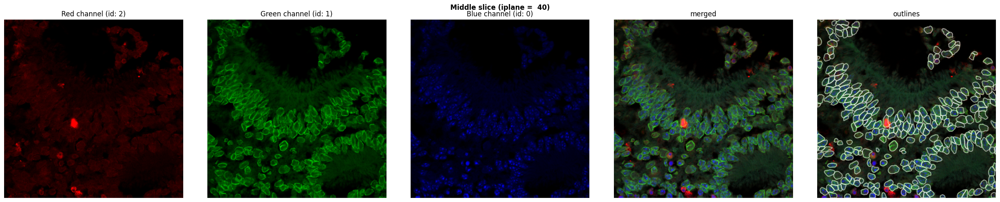

In [ ]:
#@markdown **Intensity channels and nuclear segmentation**
#@markdown <br>*also works for cellular segmentations.
name="SPE_20230327_D25"#@param {type:"string"}
img_path="/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/00_raw_data/full_zstacks/SPE_20230327_D25.tif" #@param {type:"string"}
masks_path="/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/04_cellpose3D/SPE_20230327_D25/anisotropy-4.17/3D_masks_mode-stitched2dmasks.tiff" #@param {type:"string"}
img = skimage.io.imread(img_path) #shape: (80, 250, 250, 3)
masks = skimage.io.imread(masks_path) #shape: (80, 250, 250)

print("img shape (Z x X x Y x nchannels): ", img.shape)
print("masks shape (Z x X x Y): ", masks.shape)

nplanes = img.shape[0]
nchannels = img.shape[-1]

r_channel = 2
g_channel = 1
b_channel = 0

#init
iplane = round(nplanes/2)
stacked_plane = np.dstack((img[iplane,:,:,r_channel],
                           img[iplane,:,:,g_channel],
                           img[iplane,:,:,b_channel]))
imasks = masks[iplane, :,:]

#visualisation
fig, axes = plt.subplots(1,nchannels+2,figsize=(5*(nchannels+2),5))

axes[0].imshow(img[iplane,:,:,r_channel],cmap=rgb_map.get(0))
axes[0].set_title(f'Red channel (id: {r_channel})')
axes[0].axis(False)

axes[1].imshow(img[iplane,:,:,g_channel],cmap=rgb_map.get(1))
axes[1].set_title(f'Green channel (id: {g_channel})')
axes[1].axis(False)

axes[2].imshow(img[iplane,:,:,b_channel],cmap=rgb_map.get(2))
axes[2].set_title(f'Blue channel (id: {b_channel})')
axes[2].axis(False)

axes[3].imshow(stacked_plane)
axes[3].set_title('merged')
axes[3].axis(False)

axes[4].imshow(stacked_plane); axes[4].set_title("outlines")
for o in outlines_list(imasks):
    axes[4].plot(o[:,0], o[:,1], color='w', alpha=0.5)

for ax in axes:
    ax.axis("off")

plt.suptitle(f"Middle slice (iplane =  {iplane})", weight="bold")
plt.tight_layout()
plt.show();

# Parameter selection

**Description**<br>
selection based on
- inspection of a few planes (user specifies the iplanes -- here: top, middle, bottom)
- whether foci are correctly separated in small subsections


**Output**<br>
for each selected iplane
1. merged intensity matrix
2. selected channel intensity matrix
3. binarised matrix
4. smoothed matrix
5. label matrix - rainbow


Erosion and dilation

**user input**
- kernel_size (tup (int, int)) - the smaller the kernel size, the more details are retained. Increasing kernel size likely leads to merging of regions.
- erode, dilate (int) - number of iterations for the erosion and dilation process.

In [ ]:
#@markdown **data**
selected_channel = 0 #@param {type:"number"}

#@markdown **contrast options**
separate_planes_contrast = True #@param {type:"boolean"}
min_q = 0.8 # @param {type:"slider", min:0, max:1, step:0.001}
max_q = 1 # @param {type:"slider", min:0, max:1, step:0.001}

#@markdown **otsu options**
separate_planes_otsu = True #@param {type:"boolean"}
otsu_within_regions = True #@param {type:"boolean"}
mask_matrix = (masks if otsu_within_regions else None)

#@markdown **smooth options**
kernel_size=(2,2) #@param {type:"raw"}
erode = 2 #@param {type:"number"}
dilate = 2 #@param {type:"number"}

#@markdown **segmentation options**<br>
#@markdown If algorithm: watershed, provide `compactness`.<br>
#@markdown If random_walker, provide `beta`.
algorithm = "watershed" #@param ['none', 'watershed', 'random_walker']
compactness = 0 # @param {type:"number"}
beta = 0 #@param {type:"number"}

#@markdown **visualisation options**
iplanes_plot = [0, round(nplanes/2), nplanes-1] #@param {type:"raw"}

#@markdown **export**
output_dir = f"/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/05_foci_segmentation/{name}" #@param {type:"raw"}

#@markdown [code: printing options]
options_dict = {
    "data": {
        "img_path": img_path,
        "mask_path": masks_path
    },
    "selected_channel": selected_channel,
    "contrast_options": {
        "separate_planes_contrast":separate_planes_contrast,
        "min_q": min_q,
        "max_q": max_q
    },
    "otsu_options": {
        "separate_planes_otsu":separate_planes_otsu,
        "otsu_within_regions": otsu_within_regions
    },
    "smooth_options": {
        "kernel_size": kernel_size,
        "erode": erode,
        "dilate": dilate
    },
    "segmentation_options": {
        "algorithm": algorithm,
        "compactness": compactness,
        "beta": beta
    },
    "visualization_options": {
        "iplanes_plot": iplanes_plot
    }
}

print("Settings:")
for key, value in options_dict.items():
    print(f"\t{key}: {value}")

if len(output_dir)>0 and not os.path.exists(output_dir):
    os.makedirs(output_dir)
    print(f"\t{datetime.now()}\tMade a directory: {output_dir}")

print(f"\nOutput will be saved in '{output_dir}'")


Settings:
	data: {'img_path': '/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/00_raw_data/full_zstacks/SPE_20230327_D25.tif', 'mask_path': '/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/04_cellpose3D/SPE_20230327_D25/anisotropy-4.17/3D_masks_mode-stitched2dmasks.tiff'}
	selected_channel: 0
	contrast_options: {'separate_planes_contrast': True, 'min_q': 0.8, 'max_q': 1}
	otsu_options: {'separate_planes_otsu': True, 'otsu_within_regions': True}
	smooth_options: {'kernel_size': (2, 2), 'erode': 2, 'dilate': 2}
	segmentation_options: {'algorithm': 'watershed', 'compactness': 0, 'beta': 0}
	visualization_options: {'iplanes_plot': [0, 40, 79]}

Output will be saved in '/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/05_foci_segmentation/SPE_20230327_D25'


# Binarisation (Semantic segmentation)

In [ ]:
# process
print(f"{datetime.now()}\tStarted processing")
channel_matrix = img[:,:,:,selected_channel]

if (min_q, max_q) != (0,1):
    print(f"{datetime.now()}\t\tIncreasing exposure")
    if separate_planes_contrast:
        contrast_matrix = increase_exposure_per_plane(channel_matrix, (min_q, max_q), show=False)
    else:
        contrast_matrix = increase_exposure(channel_matrix, (min_q, max_q), show=False)
else:
    contrast_matrix = copy.deepcopy(channel_matrix)

print(f"{datetime.now()}\t\tBinarising with otsu thresholding")
if separate_planes_otsu:
    otsu_matrix = binarise_with_otsu_per_plane(contrast_matrix, mask_matrix ,verbose=False)
else:
    otsu_matrix = binarise_with_otsu(contrast_matrix, mask_matrix,verbose=False)

print(f"{datetime.now()}\t\tSmoothing")
smooth_matrix = smooth(otsu_matrix, kernel_size, erode, dilate)

print(f"{datetime.now()}\tFinished processing")

2024-04-19 01:17:52.079308	Started processing
2024-04-19 01:17:52.081157		Increasing exposure
2024-04-19 01:17:54.008749		Binarising with otsu thresholding
2024-04-19 01:17:54.444700		Smoothing
2024-04-19 01:17:54.656968	Finished processing


#Showing x-y subsections of the stack

In [ ]:
windows= ((600, 800, 500, 700),
          (0, 200, 300, 500),
          (200, 400, 800, 1000),
          (0,1200,0,1200))

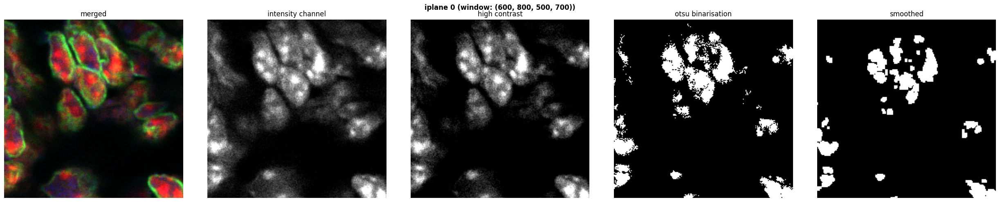

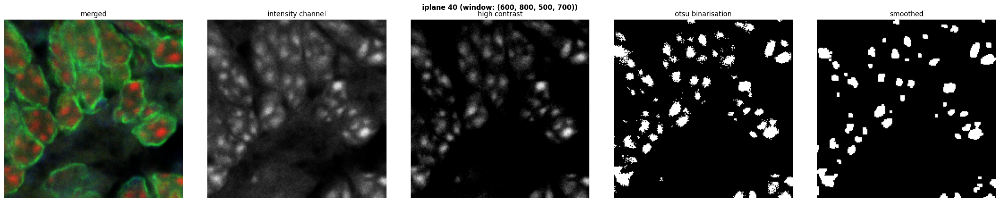

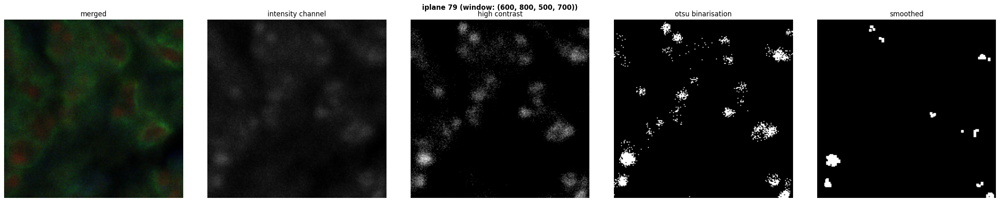

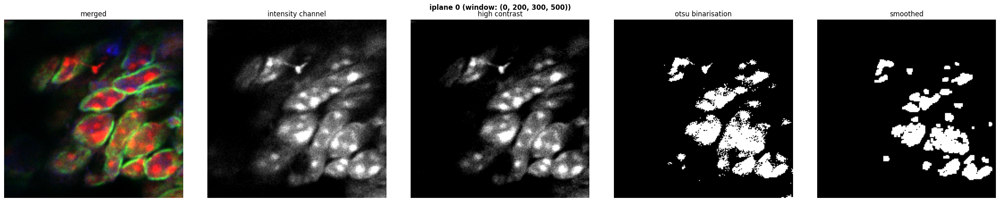

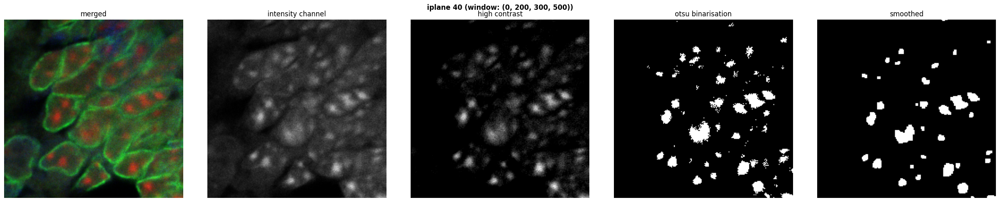

...

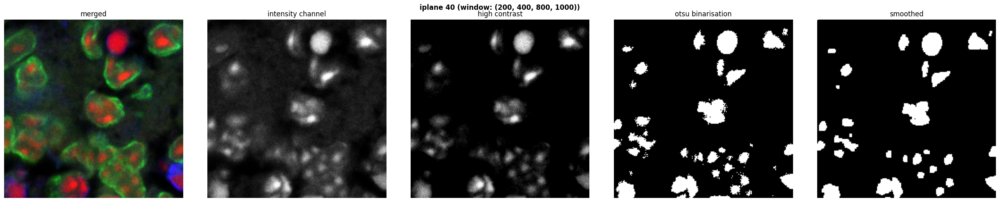

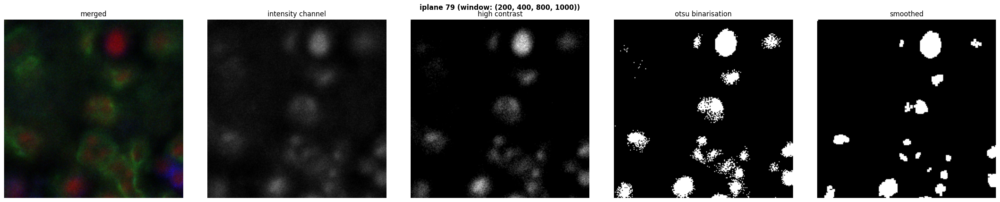

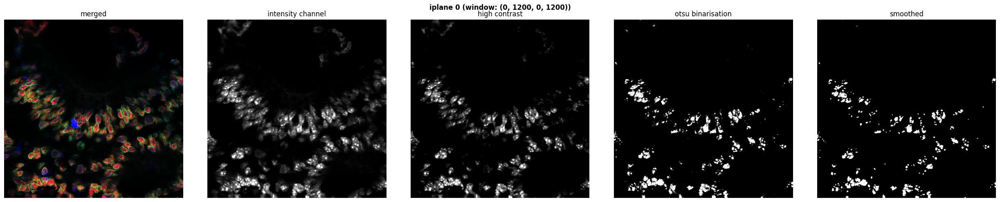

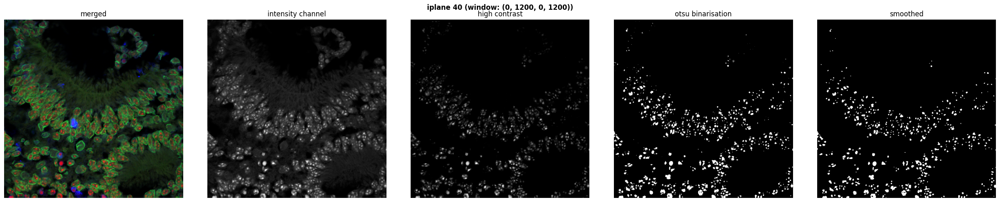

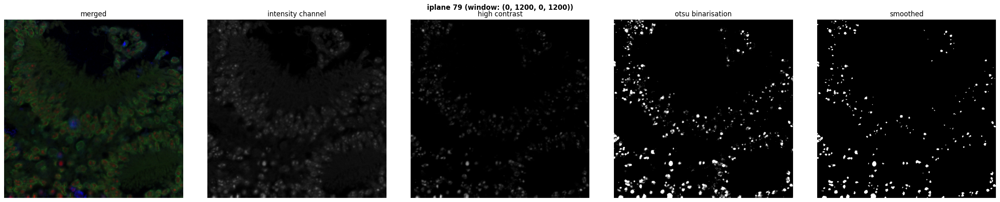

In [ ]:
#@markdown [code]
xy_inverted = True #@param {type:"boolean"}
for window in windows:
    for iplane_plot in iplanes_plot:
        plot_binarisation_progress(iplane_plot, img, nchannels, channel_matrix,
                                   contrast_matrix, otsu_matrix, smooth_matrix,
                                   window=window, xy_inverted=xy_inverted,
                                   save=f"{name}_{window}_{iplane_plot}.png")


## Instance segmentation

**Instructions**<br>
Continue if the binarisation looks good.

In [ ]:
#@markdown [code: instance segmentation]
print(f"{datetime.now()}\t\tInstance segmentation")
label_matrix = binarised2label_3d(smooth_matrix, channel_matrix, algorithm, compactness, beta)
print(f"{datetime.now()}\t\tFinished segmentation")

2024-04-19 01:27:31.613607		Instance segmentation


<ipython-input-9-d96746f36dbd>:25: FutureWarning: indices argument is deprecated and will be removed in version 0.20. To avoid this warning, please do not use the indices argument. Please see peak_local_max documentation for more details.
  local_maxi = peak_local_max(distance, indices=False,


2024-04-19 01:38:55.311608		Finished segmentation


## Showing subsections

In [ ]:
def plot_segmentation_planes(iplane_plot, img, channel_matrix, contrast_matrix,
                             otsu_matrix, smooth_matrix, label_matrix, masks,
                             window=None, bg_id=0, alpha=0.3, save=False,
                             output_dir=""):
    """Plot processed image and segmentations for a given iplane_plot.

    Args:
        iplane_plot (int): Index of the plane to plot.
        img (numpy.ndarray): image matrix. shape: (iplanes, x, y, nchannels).
        channel_matrix (numpy.ndarray): Intensity channel matrix.
        contrast_matrix (numpy.ndarray): High contrast matrix.
        otsu_matrix (numpy.ndarray): Otsu binarisation matrix (semantic segmentation).
        smooth_matrix (numpy.ndarray): Smoothed matrix.
        label_matrix (numpy.ndarray): Foci label matrix (instance segmentation).
        masks (numpy.ndarray): Nuclear masks array
        window (tuple of ints, optional): x0,x1,y0,y1
        bg_id (int): Background label ID. Default:0
        alpha (float, optional): Alpha value for overlaying segmentation. Default: 0.3.
        save (bool, optional): Whether to save the plot. Default: False.
        output_dir (str, optional): Output directory to save the plot.
                                    Default: "" (current working directory).

    Returns:
        N/A
    """
    # Create a stacked plane
    nchannels=img.shape[-1]
    stacked_plane = np.dstack(tuple(img[iplane_plot, :, :, i] for i in range(nchannels)))

    #Get subsection (optional)
    if isinstance(window, tuple):
        x0, x1, y0, y1 = window
        stacked_plane = stacked_plane[x0:x1, y0:y1, :]
        channel_matrix = channel_matrix[:, x0:x1, y0:y1]
        contrast_matrix = contrast_matrix[:, x0:x1, y0:y1]
        otsu_matrix = otsu_matrix[:, x0:x1, y0:y1]
        smooth_matrix = smooth_matrix[:, x0:x1, y0:y1]
        label_matrix = label_matrix[:, x0:x1, y0:y1]
        masks = masks[:, x0:x1, y0:y1]

    # Create subplots
    fig, axes = plt.subplots(1, 7, figsize=(35, 5))

    # Plot merged image
    axes[0].set_title("merged")
    axes[0].imshow(stacked_plane)

    # Plot intensity channel
    axes[1].set_title("intensity channel")
    axes[1].imshow(channel_matrix[iplane_plot, :, :], cmap='gray', vmin=0, vmax=255)

    # Plot high contrast
    axes[2].set_title("high contrast")
    axes[2].imshow(contrast_matrix[iplane_plot, :, :], cmap='gray')

    # Plot Otsu binarisation
    axes[3].set_title("otsu binarisation")
    axes[3].imshow(otsu_matrix[iplane_plot, :, :], cmap='gray')

    # Plot smoothed
    axes[4].set_title("smoothed")
    axes[4].imshow(smooth_matrix[iplane_plot, :, :], cmap='gray')

    # Plot foci segmentation
    axes[5].set_title("segmented")
    for i in [5,6]:
        axes[i].imshow(skimage.color.label2rgb(label=label_matrix[iplane_plot, :, :],
                                                image=channel_matrix[iplane_plot, :, :],
                                                bg_label=bg_id,
                                                bg_color=None,
                                                kind='overlay',
                                                alpha=alpha))

    # Plot including nuclear segmentations
    axes[6].set_title("including nuclear segmentations")
    for o in outlines_list(masks[iplane_plot, :, :]):
        axes[6].plot(o[:, 0], o[:, 1])

    # Turn off axes
    for ax in axes:
        ax.axis("off")

    # Set title
    plt.suptitle(f"iplane {iplane_plot}", weight="bold")
    plt.tight_layout()

    # Save or show the plot
    if save:
        plt.savefig(output_dir)

    plt.show()

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


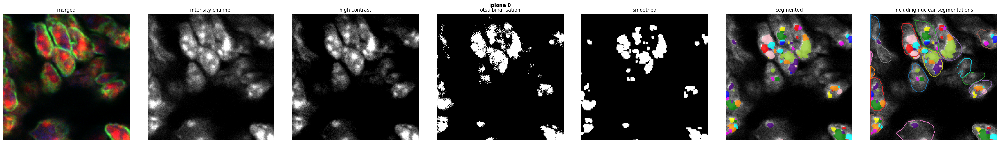

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


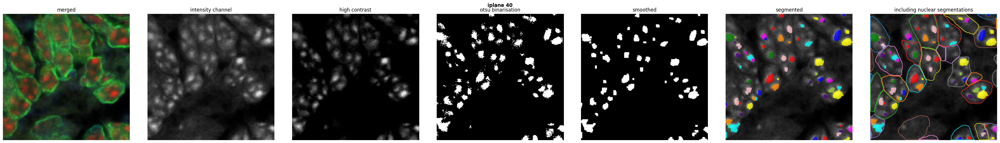

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


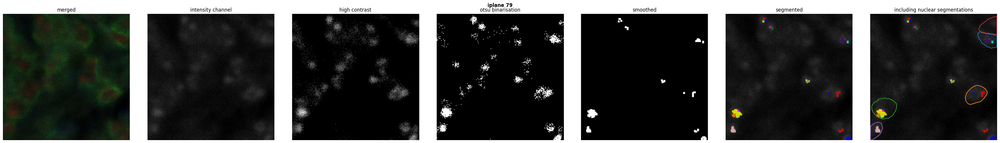

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


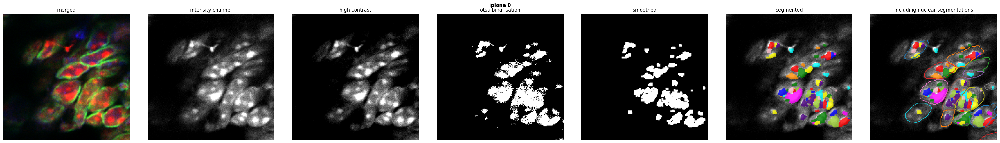

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


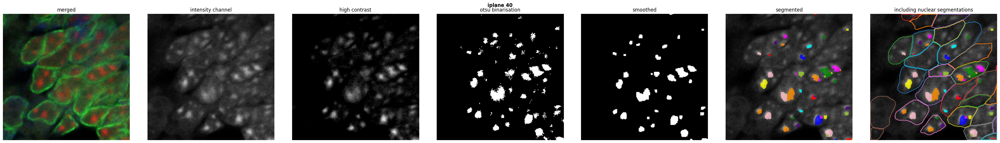

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


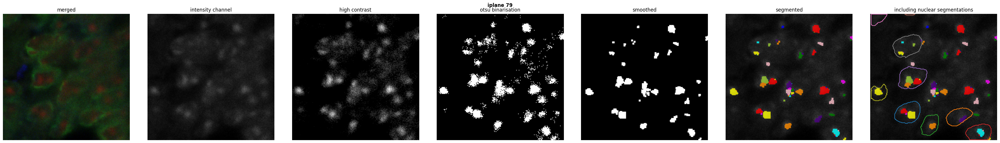

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


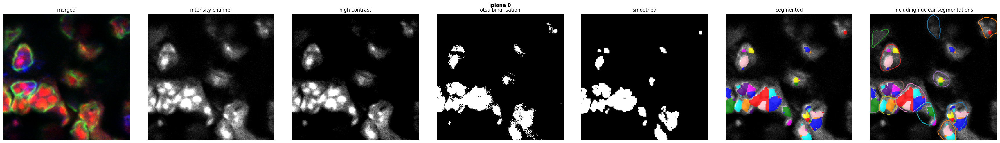

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


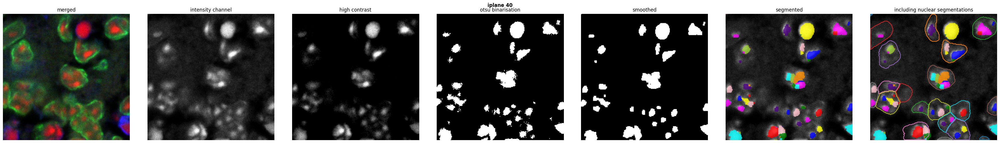

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


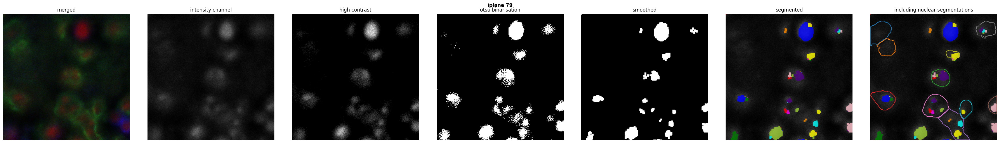

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


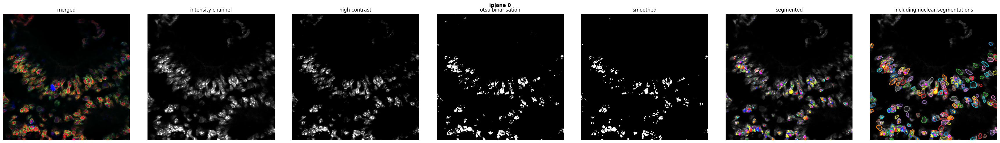

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


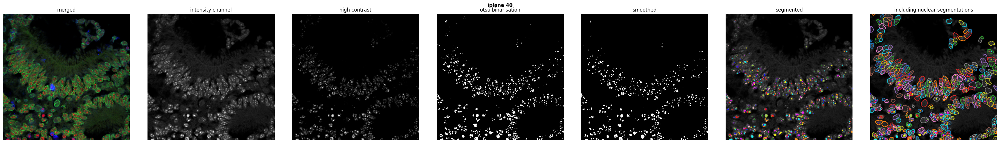

DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


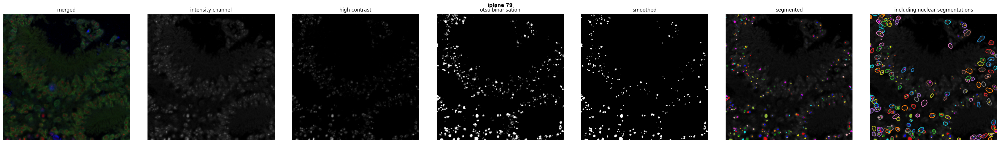

In [ ]:
#@markdown [code]
alpha = 0.8 # @param {type:"slider", min:0, max:1, step:0.1}
save=True #@param {type:"boolean"}
xy_inverted=True

#plot
for window in windows:
    filename=f"{name}_{window}_{iplane_plot}_segmentations.png"

    if xy_inverted:
        window = (window[-2],window[-1],window[0],window[1])

    for iplane_plot in iplanes_plot:

        plot_segmentation_planes(iplane_plot,
                                img,
                                channel_matrix,
                                contrast_matrix,
                                otsu_matrix,
                                smooth_matrix,
                                label_matrix,
                                masks=masks,
                                window=window,
                                bg_id=0,
                                alpha=alpha,
                                save=save,
                                output_dir=filename)

#Export label matrix


In [ ]:
outname= f"/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/05_foci_segmentation/SPE_20230327_D25/{name}_channel{selected_channel}_labels.tiff"
tifffile.imwrite(outname, label_matrix, bigtiff=True)

## export
The intermediate matrices (e.g., contrast, binarised and smoothed) dont take much time to create, whereas label does. in case intermediate matrices are required, make them using the original settings.

- json file with settings and filtering settings
- pngs of the results
- 2D label matrix


In [ ]:
#json
import json

output_file_path = f"/content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/05_foci_segmentation/SPE_20230327_D25/.settings.json"
with open(output_file_path, 'w') as json_file:
    json.dump(options_dict, json_file, indent=4)

print(f"JSON file created at {output_file_path}")

JSON file created at /content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/05_foci_segmentation/SPE_20230327_D25/.settings.json


In [ ]:
#2d label matrix
import tifffile

output_labels_path = f"{output_dir}/labels.tiff"
tifffile.imwrite(output_labels_path, label_matrix, bigtiff=True)

print(f"Matrix file created at {output_labels_path}")

Matrix file created at /content/gdrive/MyDrive/msc-internship_HI_2024_vmp/02_results/05_foci_segmentation/D25_test_subsection/labels.tiff


# Dump zone
random code snippets created during development, but currently not used.

## Object design

- object name:
- attributes:
        identifier (arbitrary)
        
        #general
        img_matrix (path)
        binary_matrix (ndarray)
        label_matrix (ndarray)

        #binarisation - settings
        binarised_channel_idx (int)
        contrast args: {minq, maxq, full_stack}
        smooth args: {kernel, erosion, dilation}           
        
        #instance segmentation - settings
        algo: ['none', 'watershed', 'random_walker']


## Nucleus filtering
remove nucleus masks if foci are on nucleus borders.

for each label, check which nucleus id are in the label region

adjust get_overlapping_masks to include plane_id column

In [ ]:
def get_comparison_ids_within_region(reference_matrix, reference_id, comparison_matrix):
    search_window = comparison_matrix[np.where(reference_matrix == reference_id)]
    comparison_ids = list(np.unique(search_window))

    return comparison_ids

def get_overlapping_masks(reference_object, comparison_object,
                          reference_name='reference', comparison_name='comparison'):
    """Determine which masks from two matrices overlap with each other

    Args:
        reference_object: ndarray reference matrix.
        comparison_object:  ndarray comparison matrix.

    Returns:
        pd.DataFrame: A DataFrame containing information about overlapping masks.
            The columns are as follows:
                - reference_id: ID of the mask in the reference matrix.
                - comparison_id: ID of the mask in the comparison matrix.
                - reference_size: Size of the mask in the reference matrix.
                - comparison_size: Size of the mask in the comparison matrix.
                - intersection_size: Size of the intersection between the masks.
                - union_size: Size of the union between the masks.
                - jaccard_index: Jaccard index calculated between the masks.
                - dice_coefficient: Dice coefficient calculated between the masks.
    """

    data_list = []

    reference_ids = list(np.unique(reference_object))
    reference_ids.remove(0)

    for reference_id in reference_ids:
        reference_px = np.column_stack(np.where(reference_object == reference_id))
        reference_tuples = list(map(tuple, reference_px))

        match_found=False

        #get comparison_ids within the region (computation efficiency)
        comparison_ids = get_comparison_ids_within_region(reference_object,
                                                          reference_id,
                                                          comparison_object)

        if 0 in comparison_ids:
            comparison_ids.remove(0)

        for comparison_id in comparison_ids:
            comparison_px = np.column_stack(np.where(comparison_object == comparison_id))
            compare_tuples = list(map(tuple, comparison_px))

            intersection_px = set(reference_tuples).intersection(set(compare_tuples))


            if len(intersection_px) > 0 :
                match_found = True

                union_px = set(reference_tuples).union(set(compare_tuples))

                jaccard_index = len(intersection_px) / len(union_px)
                dice_coefficient = (2 * len(intersection_px)) / (len(reference_px) + len(comparison_px))

                data = {f"{reference_name}_id": reference_id ,
                        f"{comparison_name}_id": comparison_id,
                        f"{reference_name}_size": len(reference_px) ,
                        f"{comparison_name}_size": len(comparison_px),
                        "intersection_size": len(intersection_px),
                        "union_size": len(union_px),
                        "jaccard_index": jaccard_index,
                        "dice_coefficient": dice_coefficient}
                data_list.append(data)

        if not match_found:
            data = {f"{reference_name}_id": reference_id ,
                    f"{comparison_name}_id": -1,
                    f"{reference_name}_size": len(reference_px),
                    f"{comparison_name}_size": -1,
                    "intersection_size": -1,
                    "union_size": -1,
                    "jaccard_index": -1,
                    "dice_coefficient": -1}
            data_list.append(data)

    df = pd.DataFrame(data_list)

    return df

## show overlapping nuclei

In [ ]:
iplane = 40
reference_matrix = label_matrix[iplane,:,:]
comparison_matrix = mask_matrix[iplane, :,: ]
reference_id = np.unique(reference_matrix)[1] #4700

_ = get_overlapping_masks(reference_matrix, comparison_matrix,
                          reference_name='foci', comparison_name='nuclei')

_

,foci_id,nuclei_id,foci_size,nuclei_size,intersection_size,union_size,jaccard_index,dice_coefficient
0,4700.0,27,41,1450,7,1484,0.004717,0.009390
1,4700.0,58,41,218,32,227,0.140969,0.247104
2,4701.0,1,28,628,24,632,0.037975,0.073171
3,4702.0,2,15,891,15,891,0.016835,0.033113
4,4703.0,1,4,628,4,628,0.006369,0.012658
...,...,...,...,...,...,...,...,...
119,4815.0,34,97,999,51,1045,0.048804,0.093066
120,4816.0,19,1,1448,1,1448,0.000691,0.001380
121,4817.0,19,1,1448,1,1448,0.000691,0.001380
122,4818.0,19,36,1448,36,1448,0.024862,0.048518


DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import
DEV: REMOVE outlines_list def FROM FINAL. USE outlines_list from cellpose.utils import


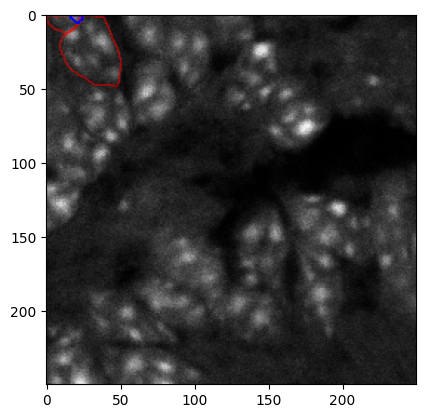

In [ ]:
filtered_foci_matrix = np.where(np.isin(reference_matrix, [reference_id]), reference_matrix, 0)
filtered_nucleus_matrix = np.where(np.isin(comparison_matrix, inspecting_nuclei_ids), comparison_matrix, 0)

plt.imshow(channel_matrix[iplane, :,:], cmap='gray')

for o in outlines_list(filtered_nucleus_matrix):
    plt.plot(o[:,0], o[:,1], color='r', alpha=0.5)
for o in outlines_list(filtered_foci_matrix):
    plt.plot(o[:,0], o[:,1], color='b')

In [ ]:
_[_['intersection_size']/_['foci_size'] > 0.3]

,foci_id,nuclei_id,foci_size,nuclei_size,intersection_size,union_size,jaccard_index,dice_coefficient
1,4700.0,58,41,218,32,227,0.140969,0.247104
2,4701.0,1,28,628,24,632,0.037975,0.073171
3,4702.0,2,15,891,15,891,0.016835,0.033113
4,4703.0,1,4,628,4,628,0.006369,0.012658
5,4704.0,27,15,1450,15,1450,0.010345,0.020478
...,...,...,...,...,...,...,...,...
119,4815.0,34,97,999,51,1045,0.048804,0.093066
120,4816.0,19,1,1448,1,1448,0.000691,0.001380
121,4817.0,19,1,1448,1,1448,0.000691,0.001380
122,4818.0,19,36,1448,36,1448,0.024862,0.048518


## Show statistics
https://scikit-image.org/docs/stable/api/skimage.measure.html#skimage.measure.regionprops

https://nl.mathworks.com/help/images/ref/regionprops.html

- per focus:<br>
        roundness vs area

In [ ]:
import pandas as pd
import math

In [ ]:
def calculate_roundness(region_mask):
    """Return the roundness of a 2D mask region.

    Args:
        region_mask

    notes:
        - props.perimeter is not used as it has the tendency to break when region_masks are small
        https://nl.mathworks.com/matlabcentral/answers/357994-perimeter-used-by-regionprops

    """
    roundness = (4 * math.pi * region_mask.area) / (region_mask.perimeter ** 2)
    return (-1 if roundness == float('inf') else roundness)

def calculate_ideal_perimeter(region_mask):
    ideal_radius = region_mask.equivalent_diameter_area / 2
    return (2 * math.pi * ideal_radius)

In [ ]:
props = skimage.measure.regionprops(selected_label_matrix)
props_df = pd.DataFrame(skimage.measure.regionprops_table(selected_label_matrix,
                                                          properties=['label',
                                                                      'area',
                                                                      'perimeter']))
# add circularity column
props_df['roundness'] = [calculate_roundness(regionmask) for regionmask in props]
#props_df['ideal_perimeter'] = [ideal_perimeter(regionmask) for regionmask in props]
#props_df['peri/ideal_peri'] = props_df['perimeter'] / props_df['ideal_perimeter']
#props_df['ideal_peri/peri'] = props_df['ideal_perimeter'] / props_df['perimeter']
props_df


<ipython-input-177-f49ccdd6c7f9>:12: RuntimeWarning: divide by zero encountered in scalar divide
  roundness = (4 * math.pi * region_mask.area) / (region_mask.perimeter ** 2)


,label,area,perimeter,roundness
0,1,27,16.828427,1.198082
1,2,34,20.242641,1.042688
2,3,46,22.485281,1.143329
3,4,1,0.000000,-1.000000
4,5,23,15.414214,1.216452
5,6,40,23.656854,0.898164
6,7,63,29.656854,0.900120
7,8,34,19.071068,1.174732
8,9,58,27.071068,0.994551
9,10,42,22.242641,1.066808


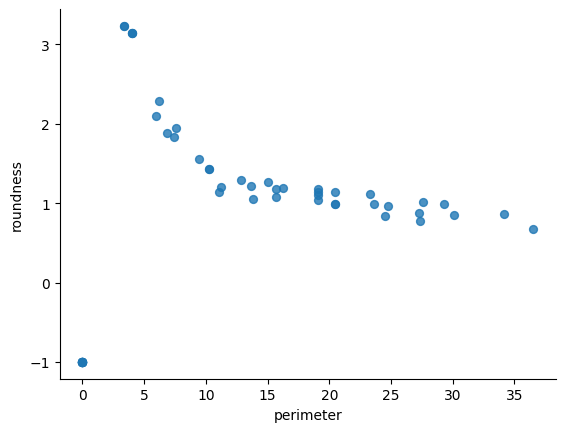

In [ ]:
# @title perimeter vs roundness

from matplotlib import pyplot as plt
props_df.plot(kind='scatter', x='perimeter', y='roundness', s=32, alpha=.8)
plt.gca().spines[['top', 'right',]].set_visible(False)

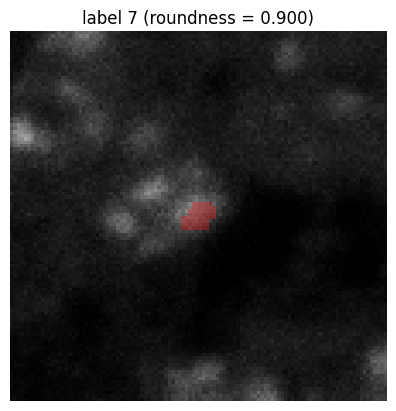

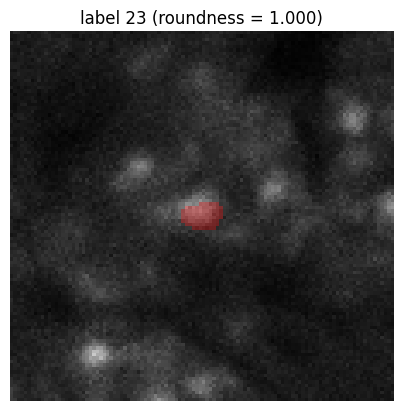

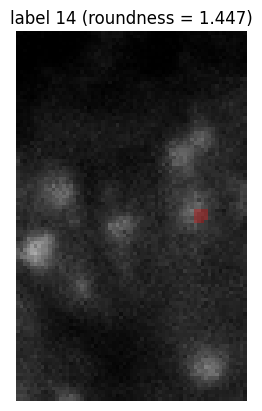

In [ ]:
iplane=60
ichannel=0

label_matrix = selected_label_matrix
img_matrix = img[iplane, :,:,ichannel]
alpha=0.3
zoom_in = True
padding = 50

#show single region
selected_regionids = [7, 23, 14]

for idx in selected_regionids:
    show_mask(label_matrix, img_matrix, [idx], alpha, zoom_in, padding)
    roundness = float(props_df.loc[props_df['label'] == idx, 'roundness'].iloc[0])
    plt.axis("off")
    plt.title(f"label {idx} (roundness = {roundness:.3f})");
    plt.show();


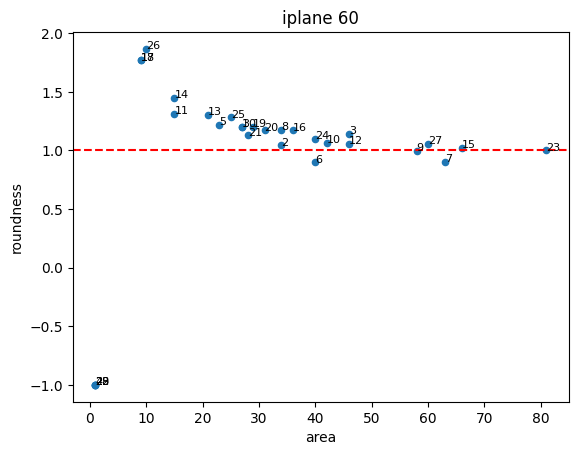

In [ ]:
props_df.plot.scatter(x='area', y='roundness')
for _, row in props_df.iterrows():
    plt.text(row['area'], row['roundness'], str(row['label'])[:-2], fontsize=8)
plt.axhline(y=1, color='r', linestyle='--')
plt.title(f"iplane {iplane}");


high `roundness`when area is small due to calculations of roundness.


Inspection each label


- x= iplane, y=area -- parabola (opens up)
- x= iplane, y=roundness -- roundness should be at 1.

## Filtering

- Volume

https://scikit-image.org/docs/stable/api/skimage.morphology.html#skimage.morphology.remove_small_objects


## Isolate nuclei

*Pseudocode*

Input: mask id.
1. `x0,x1,y0,y1,z0,z1`&emsp;Find the min and max for x, y, and z (across all slices)
2. Get the window (box)
3. Remove all other masks
4. `single_nucleus`&emsp;Get all px in 3D from the img
    - Include option to export the 3D segmentation of a single nucleus


## Quality check

indicator of quality of nucleus segmentation<br>
1. how many chromocentre segmentations fall in two or more nucleus masks?
2. how many DAPI spots fall **outside** of nucleus masks?
        note: can also be affected by staining quality



## hist - otsu

In [ ]:
def hist(img_matrix, val, iplane=None, ichannel=None):
    """plot the otsu threshold

    code adjusted from https://scipy-lectures.org/packages/scikit-image/auto_examples/plot_threshold.html
    """
    if len(img_matrix.shape) == 4:
        img_plane = img_matrix[iplane,:,:,ichannel]
    else:
        img_plane = img_matrix

    hist, bins_center = skimage.exposure.histogram(img_plane)

    plt.figure(figsize=(9, 4))
    plt.subplot(131)
    plt.imshow(img_plane, cmap='gray', interpolation='nearest')
    plt.axis('off')
    plt.subplot(132)
    plt.imshow(img_plane < val, cmap='gray', interpolation='nearest')
    plt.axis('off')
    plt.subplot(133)
    plt.plot(bins_center, hist, lw=2)
    plt.axvline(val, color='k', ls='--')

    plt.tight_layout()
    plt.show();

## Overlaying a filter

## Otsu based on single plane vs full stack

In [ ]:
iplane=79
img_plane = img_selectedchannel[iplane, :,:]
mask_plane = masks[iplane, :,:]

#otsu threshold based on single plane
binarised_iplane = otsu_within_regions_only(img_plane, mask_plane,
                                            kernel_size=(2,2), erode=3,
                                            dilate=2, plot=False)

#otsu threshold based on full stack
binarised_img = otsu_within_regions_only(img_selectedchannel, masks,
                                         kernel_size=(2,2), erode=3,
                                         dilate=2, plot=False)

fig, axes = plt.subplots(1,3, figsize=(15,5))
axes[0].imshow(img_selectedchannel[iplane,:,:]); axes[0].set_title("original")
axes[1].imshow(binarised_iplane); axes[1].set_title("otsu on single plane")
axes[2].imshow(binarised_img[iplane,:,:]); axes[2].set_title("otsu on full stack")
for ax in axes:
    ax.axis("off")

plt.suptitle(f"iplane = {iplane}", weight="bold")
plt.tight_layout()

plt.show();


NameError: name 'otsu_within_regions_only' is not defined

In [ ]:
#https://scipy-lectures.org/packages/scikit-image/auto_examples/plot_filter_coins.html#sphx-glr-packages-scikit-image-auto-examples-plot-filter-coins-py
import numpy as np
import matplotlib.pyplot as plt
from skimage import data
from skimage import filters
from skimage import restoration

iplane=40
ichannel=0

imgi = img[iplane,:,:,ichannel]

gaussian_filter_imgi = filters.gaussian(imgi, sigma=2)
med_filter_imgi = filters.median(imgi, np.ones((3, 3)))
tv_filter_imgi = restoration.denoise_tv_chambolle(imgi, weight=0.1)

plt.figure(figsize=(16, 4))
plt.subplot(141)
plt.imshow(imgi, cmap='gray', interpolation='nearest')
plt.axis('off')
plt.title('Image')
plt.subplot(142)
plt.imshow(gaussian_filter_imgi, cmap='gray',
           interpolation='nearest')
plt.axis('off')
plt.title('Gaussian filter')
plt.subplot(143)
plt.imshow(med_filter_imgi, cmap='gray',
           interpolation='nearest')
plt.axis('off')
plt.title('Median filter')
plt.subplot(144)
plt.imshow(tv_filter_imgi, cmap='gray',
           interpolation='nearest')
plt.axis('off')
plt.title('TV filter')
plt.show()

## Otsu, stack-wide, complete vs labelled regions

In [ ]:
val_all = skimage.filters.threshold_otsu(img_selectedchannel) #val = 55
otsu_all = img_selectedchannel > val_all

labelled_regions = img_selectedchannel[np.where(masks != 0)]
val_labelled = skimage.filters.threshold_otsu(labelled_regions) #val = 75
otsu_labelled = img_selectedchannel > val_labelled

for iplane in [0,20,40,60,79]:
    fig, axes = plt.subplots(1,4,figsize=(10,5))
    axes[0].imshow(np.dstack((img[iplane,:,:,0], img[iplane,:,:,1], img[iplane,:,:,2])), cmap='gray')
    axes[0].set_title("original")

    axes[1].imshow(img[iplane,:,:,0], cmap='gray')
    for o in outlines_list(masks[iplane,:,:]):
        axes[1].plot(o[:,0], o[:,1], 'r', linewidth=0.8, alpha=0.6)
    axes[1].set_title("original")

    axes[2].imshow(otsu_all[iplane,:,:], cmap='gray')
    for o in outlines_list(masks[iplane,:,:]):
        axes[2].plot(o[:,0], o[:,1], 'r', linewidth=0.8, alpha=0.6)
    axes[2].set_title("complete")

    axes[3].imshow(otsu_labelled[iplane,:,:], cmap='gray')
    for o in outlines_list(masks[iplane,:,:]):
        axes[3].plot(o[:,0], o[:,1], 'r', linewidth=0.8, alpha=0.6)
    axes[3].set_title("labelled regions only")

    for ax in axes:
        ax.axis('off')

    plt.tight_layout()
    plt.suptitle(f"iplane = {iplane}", y=0.85)
    plt.show();

## Otsu, single plane, complete vs labelled regions

In [ ]:
for iplane in [0,20,40,60,79]:
    img_plane = img_selectedchannel[iplane, :,:]
    mask_plane = masks[iplane, :,:]

    val_all = skimage.filters.threshold_otsu(img_plane)
    otsu_all = img_selectedchannel > val_all

    labelled_regions = img_plane[np.where(mask_plane != 0)]
    val_labelled = skimage.filters.threshold_otsu(labelled_regions)
    otsu_labelled = img_selectedchannel > val_labelled

    fig, axes = plt.subplots(1,4,figsize=(10,5))
    axes[0].imshow(np.dstack((img[iplane,:,:,0], img[iplane,:,:,1], img[iplane,:,:,2])), cmap='gray')
    axes[0].set_title("original")

    axes[1].imshow(img[iplane,:,:,0], cmap='gray')
    for o in outlines_list(mask_plane):
        axes[1].plot(o[:,0], o[:,1], 'r', linewidth=0.8, alpha=0.6)
    axes[1].set_title("original")

    axes[2].imshow(otsu_all[iplane,:,:], cmap='gray')
    for o in outlines_list(mask_plane):
        axes[2].plot(o[:,0], o[:,1], 'r', linewidth=0.8, alpha=0.6)
    axes[2].set_title("complete")

    axes[3].imshow(otsu_labelled[iplane,:,:], cmap='gray')
    for o in outlines_list(mask_plane):
        axes[3].plot(o[:,0], o[:,1], 'r', linewidth=0.8, alpha=0.6)
    axes[3].set_title("labelled regions only")

    for ax in axes:
        ax.axis('off')

    plt.tight_layout()
    plt.suptitle(f"iplane = {iplane}", y=0.85)
    plt.show();

## [outdated] show with nucleus outlines

In [ ]:
fig, axes = plt.subplots(2,2,figsize=(6,6))

axes[0,0].imshow(img[iplane,:,:,ichannel], cmap='gray')
for o in outlines_list(imasks):
    axes[0,0].plot(o[:,0], o[:,1], color='r')

axes[0,0].set_title("original")
axes[0,0].axis("off")

axes[0,1].imshow(mask_post1, cmap='gray')
axes[0,1].axis("off")
for o in outlines_list(imasks):
    axes[0,1].plot(o[:,0], o[:,1], color='r')

axes[1,0].imshow(img_contrast, cmap='gray')
for o in outlines_list(imasks):
    axes[1,0].plot(o[:,0], o[:,1], color='r')
axes[1,0].set_title("increased contrast")
axes[1,0].axis("off")

axes[1,1].imshow(mask_post2, cmap='gray')
for o in outlines_list(imasks):
    axes[1,1].plot(o[:,0], o[:,1], color='r')
axes[1,1].axis("off")

plt.tight_layout()
plt.show();